In [1]:
ROOT_DIR = "/home/user/Documents/projects/Metaworld"

import sys
sys.path.append(ROOT_DIR)

%matplotlib widget  
import argparse
import gc
import os
import json
import random
from PIL import Image
from typing import Dict, List, Union

import cv2
import numpy as np

import gc
import matplotlib.pyplot as plt
import torch
from torchvision.transforms import PILToTensor
import torch.nn as nn
import numpy as np
import torch.nn.functional as F
from scipy.spatial.transform import Rotation as R
import importlib
from typing import List
from easydict import EasyDict as edict
from tqdm import tqdm

# visualization
import plotly.express as px
import plotly.graph_objects as go
from lightglue import viz2d
from einops import rearrange

In [2]:
from keyframes.align_ft_spair import dataset
from keyframes.align_ft_spair.utils import geo_utils, spair_utils, ft_align_utils, depth_match_utils, geom_utils
from keyframes.align_ft_spair import pl_modules
from keyframes.align_ft_spair.ext import projection_network, utils_correspondence, utils_dataset

In [3]:
# params
spair_data_folder="/media/user/ssd2t/datasets2/SPair-71k"
embds_folder_geo="/media/user/EXTREMESSD/datasets/SPair-71k/geo"
embds_folder_sd="/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures60x60"
img_files_np_path_train="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_train_files_unique.npy"
img_files_np_path_eval="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_eval_files_unique.npy"
depth_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/miragold"
kpt_indices=[3, 4, 5]
category="aeroplane"
img_size=960
embd_size=60
pad=True

img_files_train = np.load(img_files_np_path_train).tolist()
img_files_eval = np.load(img_files_np_path_eval).tolist()

flips_train = [False]
flips_eval = [False]

In [4]:
# load embeddings
img_embds_train, img_embds_hat_train = geo_utils.load_geo_embds(
    img_files_train,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_train,
)
img_embds_train = img_embds_train.detach().cpu()
img_embds_hat_train = img_embds_hat_train.detach().cpu()

# load embeddings
img_embds_eval, img_embds_hat_eval = geo_utils.load_geo_embds(
    img_files_eval,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_eval,
)
img_embds_eval = img_embds_eval.detach().cpu()
img_embds_hat_eval = img_embds_hat_eval.detach().cpu()

# build kpt_idx_to_kpt_embds
kpt_idx_to_kpt_embds_train, kpt_embd_coords_train = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_train,
    img_embds_hat=img_embds_hat_train,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_train
)
kpt_idx_to_kpt_embds_eval, kpt_embd_coords_eval = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_eval,
    img_embds_hat=img_embds_hat_eval,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_eval
)

# average keypoint embeddings
kpt_features_avg_train = []
for kpt_index in range(30):
    kpt_features = kpt_idx_to_kpt_embds_train[kpt_index]
    if kpt_features is not None:
        kpt_features_avg_train.append(torch.mean(kpt_features, dim=0, keepdim=True))
kpt_features_avg_train = torch.cat(kpt_features_avg_train, dim=0)
# print(kpt_features_avg_train.shape)

# 1.1) load depth
depths_train = []
for img_file in img_files_train:
    fn = os.path.basename(img_file).split(".")[0]
    depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
    depth = np.load(depth_file)
    # NOTE instead of resizing depth we will resize and upscale attentions
    depths_train.append(depth)

depths_eval = []
for img_file in img_files_eval:
    fn = os.path.basename(img_file).split(".")[0]
    depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
    depth = np.load(depth_file)
    depths_eval.append(depth)

print(len(depths_train), len(depths_eval))

# 1.2) pad and resize depth
def get_pad_sizes(x):
    max_size = max(x.shape[0], x.shape[1])
    return max_size - x.shape[0], max_size - x.shape[1]

def get_pad_sizes_from_img_shape(h, w):
    max_size = max(h, w)
    return max_size - h, max_size - w

def to_torch(x):
    if isinstance(x, torch.Tensor):
        return x
    return torch.from_numpy(x)

def zero_pad_square(x):
    pad_widths = get_pad_sizes(x)
    return F.pad(to_torch(x)[None,None,:,:], [0,0,pad_widths[0]//2,pad_widths[0]//2, pad_widths[1]//2, pad_widths[1]//2], value=0)[0,0]

def inv_pad_resize_img(img_resized_padded: torch.Tensor, orig_img_h, orig_img_w):
    """
    Args:
        img_resized_padded: (H, W) tensor where H == W and has been padded to be square
    """
    pad_h, pad_w = get_pad_sizes_from_img_shape(orig_img_h, orig_img_w)
    max_size = max(orig_img_h, orig_img_w)
    # upsample img
    img_max = nn.Upsample(size=(max_size, max_size), mode='bilinear')(img_resized_padded[None, None, :, :])[0,0]  # shape (img_size, img_size)
    # crop img
    img_cropped = img_max[pad_h//2:pad_h//2+orig_img_h, pad_w//2:pad_w//2+orig_img_w]
    return img_cropped


# depths_padded_resized_train = []
# for depth in depths_train:
#     depth_padded = zero_pad_square(depth)
#     depths_padded_resized_train.append(torch.nn.MaxPool2d(2, stride=2)(
#         F.interpolate(depth_padded[None,None,:,:], (2*embd_size,2*embd_size), mode="nearest")
#     )[0,0].numpy())

# depths_padded_resized_eval = []
# for depth in depths_eval:
#     depth_padded = zero_pad_square(depth)
#     depths_padded_resized_eval.append(torch.nn.MaxPool2d(2, stride=2)(
#         F.interpolate(depth_padded[None,None,:,:], (2*embd_size,2*embd_size), mode="nearest")
#     )[0,0].numpy())


# 1.3) reproject to point clouds
# TODO maybe cause of error when reprojecting resized and padded depth
xyz_train = []
for depth in depths_train: # depths_padded_resized_train
    v0 = geom_utils.reproject_depth(depth)
    xyz_train.append(v0)

xyz_eval = []
for depth in depths_eval: # depths_padded_resized_eval
    v0 = geom_utils.reproject_depth(depth)
    xyz_eval.append(v0)

# px.imshow(depths_padded_resized_train[20])

55 27


In [8]:
xyz_train[10].shape

(337, 500, 3)

# New Match Pipeline V2

In [92]:
# TODO plane construction based on local maxima

# 1) extract local maxima
# => this gives us plane origin and plane normal, but NOT direction
# 2) find the direction of the plane => use previous technique


def extract_local_maxima():
    pass


def compute_plane_direction():
    pass

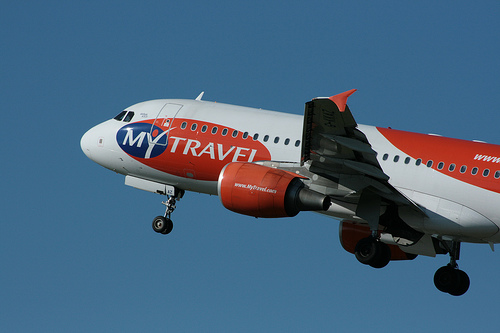

In [15]:
# let's try with landing gear
img_idx = 3
kpt_idx = 4
Image.open(img_files_train[img_idx])

In [16]:
attn = ft_align_utils.compute_attn(kpt_features_avg_train[kpt_idx][None,:], img_embds_hat_train[img_idx][None,:])
px.imshow(attn[0])

In [10]:
px.imshow(depths_train[2])

In [120]:
300/60

5.0

In [126]:
from skimage.feature import peak_local_max

def extract_local_maxima(attn: torch.Tensor, k=2):
    """
    Args:
        attn: (h, w)
    Returns:
        xy_coords: attn[xy_coords[:,1], xy_coords[:,0]] = attention values of local maxima
    """
    peak_local_maxima = peak_local_max(attn.numpy(), min_distance=10)
    peak_local_maxima_attn = attn[peak_local_maxima[:,0], peak_local_maxima[:,1]]
    peak_local_maxima_attn_sorted = torch.sort(peak_local_maxima_attn, descending=True)
    xy_coords = peak_local_maxima[peak_local_maxima_attn_sorted.indices[:k]][:,[-1,-2]]
    return xy_coords


extract_local_maxima(attn[0])

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [127]:
import pyquaternion as pyq

def construct_orthogonal_vec_torch(v):
    # normal . v = 0
    # => normal = [1/v[0], 1/v[1], -1/v[2]]
    v_np = v.numpy()
    axis = [0,0,1] if abs(v_np[1]) < 1e-3 and abs(v_np[2]) < 1e-3 else [1,0,0]
    q0 = pyq.Quaternion(axis=axis, angle=90.0) # Rotate 0 about x=y=z
    v_np /= np.linalg.norm(v_np)
    v_rotated = np.array(q0.rotate(v_np))
    x_axis = np.cross(v_rotated, v_np)
    x_axis /= np.linalg.norm(x_axis)
    return torch.from_numpy(x_axis)


def project_to_plane(center: torch.Tensor, x_axis: torch.Tensor, y_axis: torch.Tensor, x: torch.Tensor):
    x_centered = x - center
    x_proj = center + x_axis * torch.dot(x_axis, x_centered) + y_axis * torch.dot(y_axis, x_centered)
    return x_proj


def compute_plane_dir_from_stable_keypoints(
    img_embd: torch.Tensor, 
    img_xyz: torch.Tensor,
    kpt_features_avg_train: torch.Tensor,
    stable_indices: List[int],
    oriented_triangles: List[List[int]],
    # stable_threshold = 0.00048,
    stable_threshold_rate = 0.8,
    log_level = 0,
):
    """
    Args:
        - img_xyz: (h, w, 3)
    """
    # compute plane direction
    kpt_attn = ft_align_utils.compute_attn(kpt_features_avg_train, img_embd[None,:,:,:])  # (n_kpts, h, w)
    kpt_attn_max = torch.max(torch.max(kpt_attn, dim=-1).values, dim=-1).values  # (n_kpts,)
    
    thresh = stable_threshold_rate * torch.max(kpt_attn_max)
    plane_kpt_indices = np.array(stable_indices)[kpt_attn_max[stable_indices] >= thresh]
    if log_level > 0:
        print("plane_kpt_indices", plane_kpt_indices)
    plane_kpt_indices_set = set(plane_kpt_indices.tolist())
    # n_kpts = len(plane_kpt_indices)
    
    plane_kpt_xyz = []
    plane_kpt_idx_to_xyz = {}
    for kpt_index in plane_kpt_indices:
        # TODO adjust for higher resolution
        attn = inv_pad_resize_img(kpt_attn[kpt_index], img_xyz.shape[0], img_xyz.shape[1])
        local_maxima = extract_local_maxima(attn, k=2)
        v = img_xyz[local_maxima[0,1], local_maxima[0,0]]
        plane_kpt_xyz.append(v)
        plane_kpt_idx_to_xyz[kpt_index] = plane_kpt_xyz[-1]

    # construct oriented triangles
    trianlge_dirs = []
    for triangle in oriented_triangles:
        i1, i2, i3 = triangle
        if all([idx in plane_kpt_indices_set for idx in triangle]):
            # print("using triangle", triangle)
            R, t, det = geom_utils.construct_local_coord_system(
                plane_kpt_idx_to_xyz[i1].numpy(),
                plane_kpt_idx_to_xyz[i2].numpy(),
                plane_kpt_idx_to_xyz[i3].numpy()
            )
            if abs(det) > 0.001:
                trianlge_dirs.append(torch.from_numpy(R[2,:]))
    plane_dir = None
    print(len(trianlge_dirs), trianlge_dirs)
    if len(trianlge_dirs) == 0:
        if log_level > 0:
            print("Warning:", "triangles have low determinant or no triangle could be constructed")
            print("plane kpt indices", plane_kpt_indices)
    else:
        plane_dir = torch.mean(torch.stack(trianlge_dirs), dim=0)
    return plane_dir

# TODO in general case we cannot use plane dir hint
# see spair_depth.ipynb for old version of construct_plane
def construct_plane_for_v1_v2(
    v1: torch.Tensor, 
    v2: torch.Tensor, 
    plane_dir_hint: torch.Tensor,
):
    plane_origin = (v1 + v2) / 2  # (3,)
    o_v1 = v1 - plane_origin
    plane_x_axis = construct_orthogonal_vec_torch(o_v1)
    plane_y_axis = torch.cross(o_v1, plane_x_axis)
    plane_y_axis /= torch.norm(plane_y_axis)

    plane_dir_projected = project_to_plane(plane_origin, plane_x_axis, plane_y_axis, plane_origin + plane_dir_hint)
    plane_normal = plane_origin + plane_dir_hint - plane_dir_projected
    plane_normal /= torch.norm(plane_normal)

    return plane_origin, plane_normal, plane_x_axis, plane_y_axis


def construct_plane_v3(
    img_xyz: torch.Tensor,
    unstable_index_pair: List[int],
    plane_dir_hint: torch.Tensor,
    kpt_attn: torch.Tensor,  # (n_kpts, h, w)
    thresh_rate = 0.8,
):
    v1, v2, plane_origin, plane_normal, plane_x_axis, plane_y_axis = None, None, None, None, None, None

    # compute plane direction
    kpt_attn_max = torch.max(torch.max(kpt_attn, dim=-1).values, dim=-1).values  # (n_kpts,)
    kpt_attn_total_max = torch.max(kpt_attn_max)
    thresh = thresh_rate * kpt_attn_total_max

    i = 0
    kpt_index_1 = unstable_index_pair[i*2]
    kpt_index_2 = unstable_index_pair[i*2 + 1]
    if kpt_attn_max[kpt_index_1] > thresh or kpt_attn_max[kpt_index_2] > thresh:
        # TODO adjust for higher depth resolution
        # => upscale attention to original resolution
        if kpt_attn_max[kpt_index_1] > kpt_attn_max[kpt_index_2]:
            attn = kpt_attn[kpt_index_1]
        else:
            attn = kpt_attn[kpt_index_2]
        attn = inv_pad_resize_img(attn, img_xyz.shape[0], img_xyz.shape[1])
        local_maxima = extract_local_maxima(attn)
        # TODO is 0.9 a good threshold?
        if attn[local_maxima[1,1], local_maxima[1,0]] > 0.9 * attn[local_maxima[0,1], local_maxima[0,0]]:
            print("local_maxima", local_maxima)
            v1 = img_xyz[local_maxima[0,1], local_maxima[0,0]]
            v2 = img_xyz[local_maxima[1,1], local_maxima[1,0]]
            plane_origin, plane_normal, plane_x_axis, plane_y_axis = construct_plane_for_v1_v2(
                v1, v2, plane_dir_hint
            )
            
    return v1, v2, plane_origin, plane_normal, plane_x_axis, plane_y_axis


def determine_right_left(
    v1, v2, plane_origin, plane_normal
):
    # determine right left
    v1_sign = torch.dot(plane_normal, (v1 - plane_origin))
    v2_sign = torch.dot(plane_normal, (v2 - plane_origin))
    return v1_sign > v2_sign


## Check Plane Construction

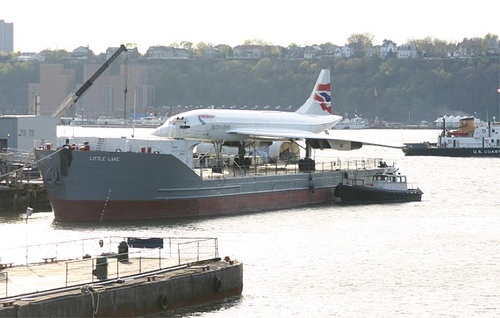

In [146]:
kpt_idx = 4
img_idx = 7
Image.open(img_files_train[img_idx])

In [147]:
# TODO construct plane for all train and eval images for a paritcular keypoint and visualize them
h, w = 60, 60
kpt_index_1 = kpt_idx - kpt_idx % 2
kpt_index_2 = kpt_index_1 + 1

# 1) compute plane for src image
img_xyz = torch.from_numpy(xyz_train[img_idx])
img_embd = img_embds_hat_train[img_idx]
kpt_attn_src = ft_align_utils.compute_attn(kpt_features_avg_train, img_embd[None,:,:,:])
plane_dir_hint_src = compute_plane_dir_from_stable_keypoints(
    img_embd=img_embd, 
    img_xyz=img_xyz,
    kpt_features_avg_train=kpt_features_avg_train,
    stable_indices=[0,1,2,3,22,23,24],
    oriented_triangles=[[0,3,1],[0,3,2],[0,24,1],[0,24,2],[0,22,1],[0,22,2],[0,23,1],[0,23,2],[22,24,23],
    [3,24,1],[3,24,2],[3,22,1],[3,22,2],[3,23,1],[3,23,2],[2,22,23], [22,24,23]],
    stable_threshold_rate= 0.8 #0.00045
    # log_level = log_level,
)

9 [tensor([ 0.4520,  0.8631, -0.2255], dtype=torch.float64), tensor([ 0.4754,  0.8400, -0.2617], dtype=torch.float64), tensor([ 0.2344,  0.4007, -0.8857], dtype=torch.float64), tensor([ 0.2164,  0.2238, -0.9503], dtype=torch.float64), tensor([ 0.4517,  0.8621, -0.2296], dtype=torch.float64), tensor([ 0.4634,  0.7915, -0.3985], dtype=torch.float64), tensor([ 0.8027,  0.3517, -0.4816], dtype=torch.float64), tensor([ 0.1858, -0.2134, -0.9591], dtype=torch.float64), tensor([ 0.8027,  0.3517, -0.4816], dtype=torch.float64)]


In [148]:
h, w = img_xyz.shape[0], img_xyz.shape[1]
img_plane_offset_src = torch.zeros((h,w))

if plane_dir_hint_src is not None:
    # img_xyz = img_xyz.reshape((h,w,3))
    v1_src, v2_src, plane_origin_src, plane_normal_src, plane_x_axis_src, plane_y_axis_src = construct_plane_v3(
        img_xyz=img_xyz,
        unstable_index_pair=[kpt_index_1, kpt_index_2],
        plane_dir_hint=plane_dir_hint_src,
        kpt_attn=kpt_attn_src,  # (n_kpts, h, w)
        thresh_rate = 0.8
    )
    if plane_origin_src is not None and plane_normal_src is not None:
        img_xyz_src = img_xyz.reshape((-1,3))
        img_plane_offset_src = (img_xyz_src - plane_origin_src[None,:]) @ plane_normal_src[:,None]
        img_plane_offset_src = img_plane_offset_src.reshape((h, w))

local_maxima [[245 162]
 [304 163]]


In [149]:
px.imshow(img_plane_offset_src)

In [144]:
px.imshow(inv_pad_resize_img(kpt_attn_src[kpt_idx], img_xyz.shape[0], img_xyz.shape[1]))

In [63]:
importlib.reload(geom_utils)

<module 'keyframes.align_ft_spair.utils.geom_utils' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/geom_utils.py'>

In [150]:
# img_index = 1
# img_xyz_src = img_xyz.reshape((-1,3))
# # plane_origin_src, plane_normal_src, plane_x_axis_src, plane_y_axis_src
# img_plane_offset_src = (img_xyz_src - plane_origin_src[None,:]) @ plane_normal_src[:,None]

# plane_x_axis_src = torch.tensor([1,0,0]).double()
# plane_y_axis_src = torch.tensor([0,1,0]).double()
# plane_z_axis_src = torch.tensor([0,0,1]).double()

plane_grid = geom_utils.create_grid(plane_origin_src.numpy(), plane_normal_src.numpy(), 60)
plane_grid = plane_grid.reshape((-1,3))
plane_grid_2 = geom_utils.create_grid(plane_origin_src.numpy(), plane_x_axis_src.numpy(), 60)
plane_grid_2 = plane_grid_2.reshape((-1,3))
plane_grid_3 = geom_utils.create_grid(plane_origin_src.numpy(), plane_y_axis_src.numpy(), 60)
plane_grid_3 = plane_grid_3.reshape((-1,3))


fig = go.Figure(data=[
    go.Scatter3d(
        x=img_xyz_src[:,0], 
        y=img_xyz_src[:,1], 
        z=img_xyz_src[:,2],
        mode='markers',
        marker=dict(
            size=1,
            # color=z,                # set color to an array/list of desired values
            # colorscale='Viridis',   # choose a colorscale
            # opacity=0.8
        )
    ),
    go.Scatter3d(
        x=plane_grid[:,0], 
        y=plane_grid[:,1], 
        z=plane_grid[:,2],
        mode='markers',
        marker=dict(
            size=1,
            color="red",                # set color to an array/list of desired values
            # colorscale='Viridis',   # choose a colorscale
            # opacity=0.8
        )
    ),
    # go.Scatter3d(
    #     x=plane_grid_2[:,0], 
    #     y=plane_grid_2[:,1], 
    #     z=plane_grid_2[:,2],
    #     mode='markers',
    #     marker=dict(
    #         size=1,
    #         color="red",                # set color to an array/list of desired values
    #         # colorscale='Viridis',   # choose a colorscale
    #         # opacity=0.8
    #     )
    # ),
    # go.Scatter3d(
    #     x=plane_grid_3[:,0], 
    #     y=plane_grid_3[:,1], 
    #     z=plane_grid_3[:,2],
    #     mode='markers',
    #     marker=dict(
    #         size=1,
    #         color="red",                # set color to an array/list of desired values
    #         # colorscale='Viridis',   # choose a colorscale
    #         # opacity=0.8
    #     )
    # ),
    go.Scatter3d(
        x=[plane_origin_src[0], plane_origin_src[0] + 0.1 * plane_normal_src[0]], 
        y=[plane_origin_src[1], plane_origin_src[1] + 0.1 * plane_normal_src[1]], 
        z=[plane_origin_src[2], plane_origin_src[2] + 0.1 * plane_normal_src[2]],
        mode='markers',
        marker=dict(
            size=3,
            color="green",                # set color to an array/list of desired values
            # colorscale='Viridis',   # choose a colorscale
            # opacity=0.8
        )
    ),
    go.Scatter3d(
        x=[p[0] for p in [v1_src, v2_src]], 
        y=[p[1] for p in [v1_src, v2_src]], 
        z=[p[2] for p in [v1_src, v2_src]],
        mode='markers',
        marker=dict(
            size=3,
            color="orange",                # set color to an array/list of desired values
            # colorscale='Viridis',   # choose a colorscale
            # opacity=0.8
        )
    ),
    # *[
    #     go.Scatter3d(
    #         x=[xyz[0]], 
    #         y=[xyz[1]], 
    #         z=[xyz[2]],
    #         mode='markers',
    #         marker=dict(
    #             size=5,
    #             color="red",
    #             # colorscale='Viridis',   # choose a colorscale
    #             # opacity=0.8
    #         )
    #     ) for xyz in best_kpts_xyz_target
    
    # ]
])
fig.update_scenes({"aspectmode": "data"})
fig.show()

In [77]:
# perform plane construction on train image index = 3
img_plane_offsets_eval = []
kpt_index = 4
for img_index in range(len(xyz_eval)):
    print(img_index)
    h, w = 60, 60
    kpt_index_1 = kpt_index - kpt_index % 2
    kpt_index_2 = kpt_index_1 + 1

    # 1) compute plane for src image
    img_xyz = torch.from_numpy(xyz_eval[img_index])
    img_embd = img_embds_hat_eval[img_index]
    kpt_attn_src = ft_align_utils.compute_attn(kpt_features_avg_train, img_embd[None,:,:,:])
    plane_dir_hint_src = compute_plane_dir_from_stable_keypoints(
        img_embd=img_embd, 
        img_xyz=img_xyz,
        kpt_features_avg_train=kpt_features_avg_train,
        stable_indices=[0,1,2,3,22,23,24],
        oriented_triangles=[[0,3,1],[0,3,2],[0,24,1],[0,24,2],[0,22,1],[0,22,2],[0,23,1],[0,23,2],[22,24,23],
        [3,24,1],[3,24,2],[3,22,1],[3,22,2],[3,23,1],[3,23,2],[2,22,23], [22,24,23]],
        stable_threshold_rate= 0.8 #0.00045
        # log_level = log_level,
    )
    img_plane_offset_src = torch.zeros((60,60))
    if plane_dir_hint_src is not None:
        img_xyz = img_xyz.reshape((h,w,3))
        v1_src, v2_src, plane_origin_src, plane_normal_src, plane_x_axis_src, plane_y_axis_src = construct_plane_v3(
            img_xyz=img_xyz,
            unstable_index_pair=[kpt_index_1, kpt_index_2],
            plane_dir_hint=plane_dir_hint_src,
            kpt_attn=kpt_attn_src,  # (n_kpts, h, w)
            thresh_rate = 0.8
        )
        if plane_origin_src is not None and plane_normal_src is not None:
            img_xyz_src = torch.from_numpy(xyz_eval[img_index].reshape((-1,3)))
            img_plane_offset_src = (img_xyz_src - plane_origin_src[None,:]) @ plane_normal_src[:,None]
            img_plane_offset_src = img_plane_offset_src.reshape((h, w))
    img_plane_offsets_eval.append(img_plane_offset_src)


0
6 [tensor([-0.3530,  0.7290,  0.5864], dtype=torch.float64), tensor([-0.3618,  0.5899,  0.7219], dtype=torch.float64), tensor([-0.3282,  0.8490,  0.4141], dtype=torch.float64), tensor([-0.9845,  0.0424,  0.1705], dtype=torch.float64), tensor([-0.5394, -0.5905,  0.6003], dtype=torch.float64), tensor([-0.9845,  0.0424,  0.1705], dtype=torch.float64)]
1
10 [tensor([-0.6269, -0.6272, -0.4622], dtype=torch.float64), tensor([ 0.0840, -0.5823, -0.8086], dtype=torch.float64), tensor([ 0.8274, -0.0660, -0.5577], dtype=torch.float64), tensor([ 0.3735, -0.4556, -0.8081], dtype=torch.float64), tensor([-0.4259, -0.5998, -0.6774], dtype=torch.float64), tensor([-0.3370, -0.8166, -0.4686], dtype=torch.float64), tensor([-0.0615, -0.9004, -0.4306], dtype=torch.float64), tensor([-0.5117, -0.7180, -0.4719], dtype=torch.float64), tensor([ 0.8669,  0.1271, -0.4821], dtype=torch.float64), tensor([-0.4259, -0.5998, -0.6774], dtype=torch.float64)]
2
17 [tensor([-0.1838, -0.9259, -0.3300], dtype=torch.float64

In [76]:
img_plane_offsets_eval[2].shape

torch.Size([3600, 1])

In [78]:
px.imshow(ft_align_utils.concat_sims(torch.stack(img_plane_offsets_eval)))

In [65]:
img_embd.shape

AttributeError: 'tuple' object has no attribute 'shape'

## Evaluate

In [ ]:
def zero_embd(img_embd, img_sign, query_sign):
    img_embd = img_embd.clone()
    if query_sign < 0:
        img_embd[:, img_sign > 0] = 0
    else:
        img_embd[:, img_sign < 0] = 0
    return img_embd

def sim_fun_3(
    query_embd_coords: torch.Tensor, 
    img_embd_src: torch.Tensor, 
    img_embd_tgt: torch.Tensor, 
    xyz_src: torch.Tensor, 
    xyz_tgt: torch.Tensor, 
    kpt_features_avg_train: torch.Tensor,
    img_embds_train: torch.Tensor,
    kpt_embd_coords: List[torch.Tensor],
    right_left_kpt_indices: List[int],
    kpt_idx_to_kpt_embds: Dict[int, torch.Tensor],
):
    """
    Args:
        query_embd: (1, C)
        img_embd_tgt: (1, C, embd_size, embd_size)
    """
    query_x, query_y = query_embd_coords
    query_embd = img_embd_src[:, query_y, query_x]  # (C, n_q)

    # 1) find kpt like usual
    kpt_index = int(ft_align_utils.find_kpt_index(
        query_embd[None,:], 
        img_embds_train, 
        kpt_embd_coords, 
        enable_left_right_check=False
    ).item())
    img_plane_offset_tgt = None
    # 2.1) if kpt is ambitious construct planes for source and target image
    if kpt_index in right_left_kpt_indices:
        print("performing right left procedure", kpt_index)

        h, w = 60, 60
        kpt_index_1 = kpt_index - kpt_index % 2
        kpt_index_2 = kpt_index_1 + 1

        # 1) compute plane for src image
        kpt_attn_src = ft_align_utils.compute_attn(kpt_features_avg_train[kpt_index][None,:], img_embd_src[None,:])
        plane_dir_hint_src = compute_plane_dir_from_stable_keypoints(
            img_embd=img_embd_src, 
            img_xyz=xyz_src,
            kpt_features_avg_train=kpt_features_avg_train,
            stable_indices=[0,1,2,3,22,23,24],
            oriented_triangles=[[0,3,1],[0,3,2],[0,24,1],[0,24,2],[0,22,1],[0,22,2],[0,23,1],[0,23,2],[22,24,23],
            [3,24,1],[3,24,2],[3,22,1],[3,22,2],[3,23,1],[3,23,2],[2,22,23], [22,24,23]],
            stable_threshold_rate= 0.8 #0.00045
            # log_level = log_level,
        )
        xyz_src = xyz_src.reshape((h,w,3))
        v1_src, v2_src, plane_origin_src, plane_normal_src, plane_x_axis_src, plane_y_axis_src = construct_plane_v3(
            img_xyz=xyz_src,
            unstable_index_pair=[kpt_index_1, kpt_index_2],
            plane_dir_hint=plane_dir_hint_src,
            kpt_attn=kpt_attn_src,  # (n_kpts, h, w)
            thresh_rate = 0.8
        )

        if plane_origin_src is not None and plane_normal_src is not None:
            # 2) compute plane for tgt image
            kpt_attn_tgt = ft_align_utils.compute_attn(kpt_features_avg_train[kpt_index][None,:], img_embd_tgt[None,:])
            plane_dir_hint_tgt = compute_plane_dir_from_stable_keypoints(
                img_embd=img_embd_tgt, 
                img_xyz=xyz_tgt,
                kpt_features_avg_train=kpt_features_avg_train,
                stable_indices=[0,1,2,3,22,23,24],
                oriented_triangles=[[0,3,1],[0,3,2],[0,24,1],[0,24,2],[0,22,1],[0,22,2],[0,23,1],[0,23,2],[22,24,23],
                [3,24,1],[3,24,2],[3,22,1],[3,22,2],[3,23,1],[3,23,2],[2,22,23], [22,24,23]],
                stable_threshold_rate= 0.8 #0.00045
                # log_level = log_level,
            )
            xyz_tgt = xyz_tgt.reshape((h,w,3))
            v1_tgt, v2_tgt, plane_origin_tgt, plane_normal_tgt, plane_x_axis_tgt, plane_y_axis_tgt = construct_plane_v3(
                img_xyz=xyz_tgt,
                unstable_index_pair=[kpt_index_1, kpt_index_2],
                plane_dir_hint=plane_dir_hint_tgt,
                kpt_attn=kpt_attn_tgt,  # (n_kpts, h, w)
                thresh_rate = 0.8
            )

            if plane_origin_tgt is not None and plane_normal_tgt is not None:
                v_with_min_z = xyz_src[query_y, query_x]
                query_plane_offset_src = (v_with_min_z - plane_origin_src) @ plane_normal_src
            
                # 2.3) adjust kpt accordingly
                if query_plane_offset_src < 0:
                    if kpt_index % 2 == 1:
                        kpt_index -= 1
                else:
                    if kpt_index % 2 == 0:
                        kpt_index += 1
                print(query_plane_offset_src, kpt_index)

                # 2.4) zero out embds of target img with opposite sign
                img_xyz_tgt = xyz_tgt.reshape((-1,3))
                img_plane_offset_tgt = (img_xyz_tgt - plane_origin_tgt[None,:]) @ plane_normal_tgt[:,None]
                img_plane_offset_tgt = img_plane_offset_tgt.reshape((h,w))
                img_embd_tgt = zero_embd(img_embd_tgt, img_plane_offset_tgt, query_plane_offset_src)
                img_embd_tgt[:, img_xyz_tgt[:,2].reshape((60,60)) > 0.7] = 0
            # img_embd_tgt = zero_embd(img_embd_tgt, img_xyz_tgt.reshape(), query_plane_offset_src)

    # 3) compute max attention
    sim = ft_align_utils.compute_max_attn(
        kpt_embds=kpt_idx_to_kpt_embds[kpt_index], 
        test_embd=img_embd_tgt[None,:]
    )
    return sim.cpu()